In [1]:
pip install pandas-profiling;

Note: you may need to restart the kernel to use updated packages.


In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import pandas_profiling as pf
from sklearn.svm import SVC
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import *
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
import category_encoders  as ce 
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
%matplotlib inline


In [4]:
def classification_metrics(y_test,y_pred):
    print("Accuracy is: ", accuracy_score(y_test,y_pred))
    print("Precision is: ", precision_score(y_test,y_pred))
    print("Recall is: ", recall_score(y_test,y_pred))
    print("F1-Score is: ", f1_score(y_test,y_pred))

In [5]:
def roc_curve_plot(y_test,y_pred,y_train,y_pred_train):
    plt.figure(figsize=(5,5))
    fpr, tpr, thresholds = roc_curve(y_test ,y_pred)
    fpr1, tpr1, thresholds1 = roc_curve(y_train ,y_pred_train)
    plt.plot(fpr, tpr)
    plt.plot(fpr1, tpr1)
    plt.xlabel("fpr")
    plt.ylabel("tpr")
    plt.title("ROC Curve")
    plt.show()

In [7]:
churn = pd.read_csv('churn.csv')

In [8]:
churn.head()

,state,account_length,area_code,phone_number,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,class
0,16,128,415,2845,0,1,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,35,107,415,2301,0,1,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0
2,31,137,415,1616,0,0,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0
3,35,84,408,2510,1,0,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
4,36,75,415,155,1,0,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0


In [9]:
churn.shape

(5000, 21)

In [10]:
churn.isnull().sum()

state                            0
account_length                   0
area_code                        0
phone_number                     0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
class                            0
dtype: int64

In [11]:
churn.describe()

,state,account_length,area_code,phone_number,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,class
count,5000.00000,5000.00000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,...,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,25.99840,100.25860,436.911400,2499.500000,0.094600,0.264600,7.755200,180.288900,100.029400,30.649668,...,100.191000,17.054322,200.391620,99.919200,9.017732,10.261780,4.435200,2.771196,1.570400,0.141400
std,14.80348,39.69456,42.209182,1443.520003,0.292691,0.441164,13.546393,53.894699,19.831197,9.162069,...,19.826496,4.296843,50.527789,19.958686,2.273763,2.761396,2.456788,0.745514,1.306363,0.348469
min,0.00000,1.00000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,13.00000,73.00000,408.000000,1249.750000,0.000000,0.000000,0.000000,143.700000,87.000000,24.430000,...,87.000000,14.140000,166.900000,87.000000,7.510000,8.500000,3.000000,2.300000,1.000000,0.000000
50%,26.00000,100.00000,415.000000,2499.500000,0.000000,0.000000,0.000000,180.100000,100.000000,30.620000,...,100.000000,17.090000,200.400000,100.000000,9.020000,10.300000,4.000000,2.780000,1.000000,0.000000
75%,39.00000,127.00000,415.000000,3749.250000,0.000000,1.000000,17.000000,216.200000,113.000000,36.750000,...,114.000000,19.900000,234.700000,113.000000,10.560000,12.000000,6.000000,3.240000,2.000000,0.000000
max,50.00000,243.00000,510.000000,4999.000000,1.000000,1.000000,52.000000,351.500000,165.000000,59.760000,...,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000,1.000000


In [12]:
pf.ProfileReport(churn)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
churn['class'].value_counts(normalize=True)

0    0.8586
1    0.1414
Name: class, dtype: float64

In [18]:
print(churn.total_day_minutes.max())
print(churn.total_day_minutes.min())

351.5
0.0


In [19]:
churn.groupby(["total_day_minutes","number_vmail_messages"]).count().state.reset_index()

,total_day_minutes,number_vmail_messages,state
0,0.0,0,2
1,2.6,27,1
2,6.6,0,1
3,7.2,0,1
4,7.8,0,1
...,...,...,...
3063,338.4,0,1
3064,345.3,0,1
3065,346.8,0,1
3066,350.8,0,1


In [20]:
churn.groupby("phone_number").mean().total_day_minutes

phone_number
0       166.0
1       182.1
2       276.3
3       148.3
4       110.9
        ...  
4995    178.3
4996    203.4
4997    231.9
4998    186.2
4999    175.5
Name: total_day_minutes, Length: 5000, dtype: float64

In [21]:
tdm=churn.groupby("phone_number").mean().total_day_minutes

<AxesSubplot:xlabel='total_day_minutes'>

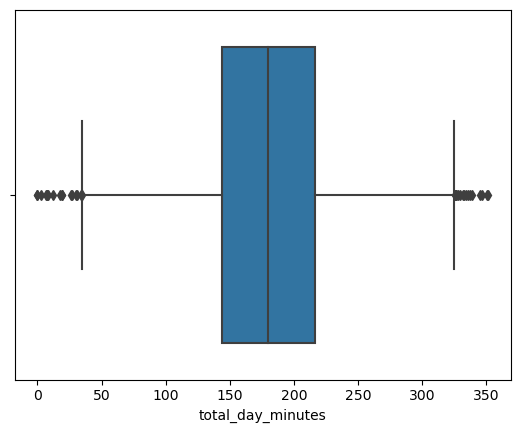

In [22]:
sns.boxplot(x=tdm)

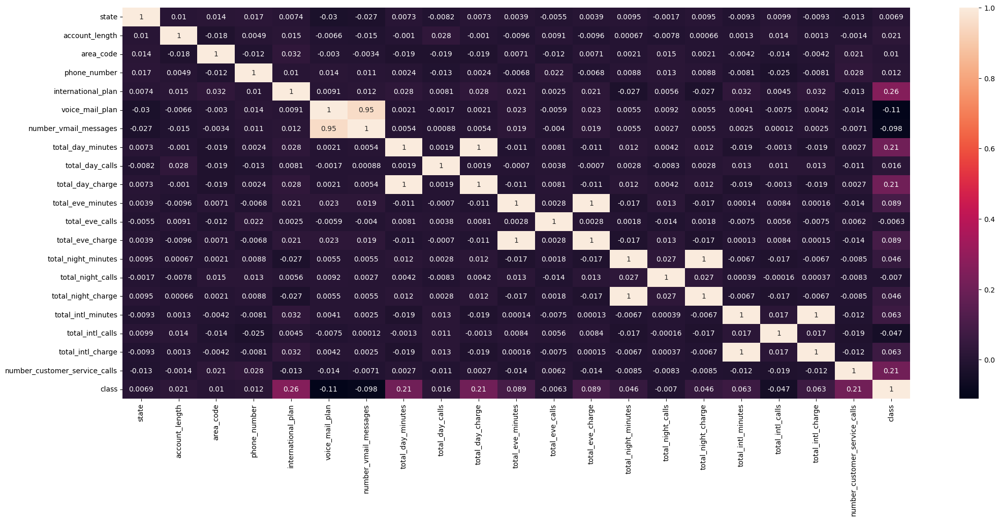

In [23]:
plt.figure(figsize=(25,10))
sns.heatmap(churn.corr(), annot=True)
plt.show()

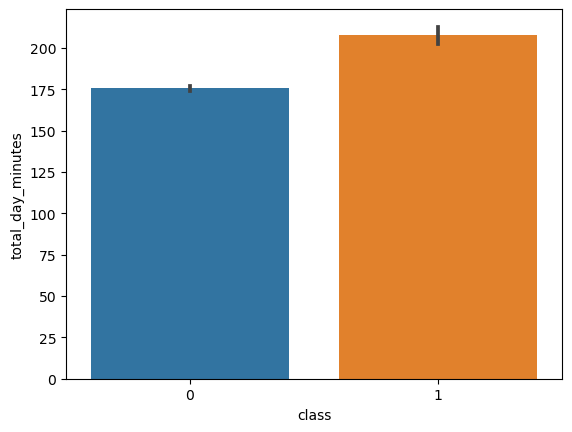

In [24]:
sns.barplot( data=churn ,x="class",y="total_day_minutes");

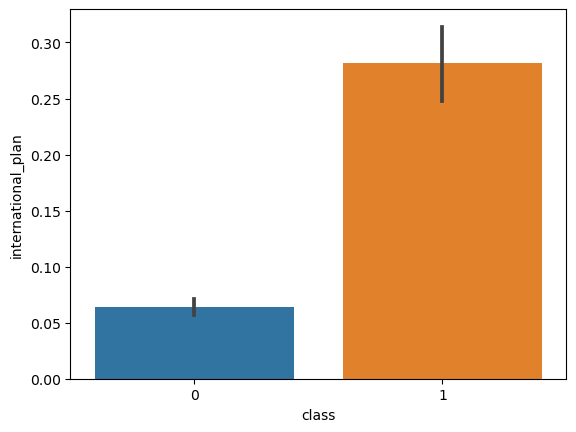

In [25]:
sns.barplot( data=churn ,x="class",y="international_plan");

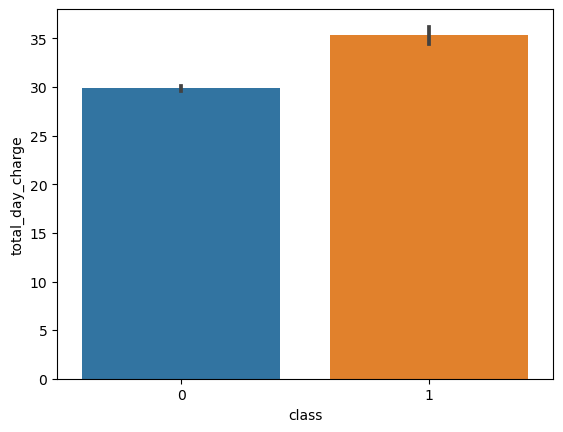

In [26]:
sns.barplot( data=churn ,x="class",y="total_day_charge");

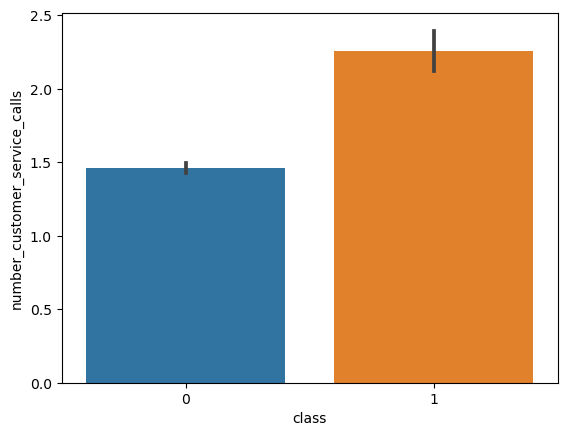

In [27]:
sns.barplot( data=churn ,x="class",y="number_customer_service_calls");

<AxesSubplot:xlabel='total_day_minutes', ylabel='total_day_charge'>

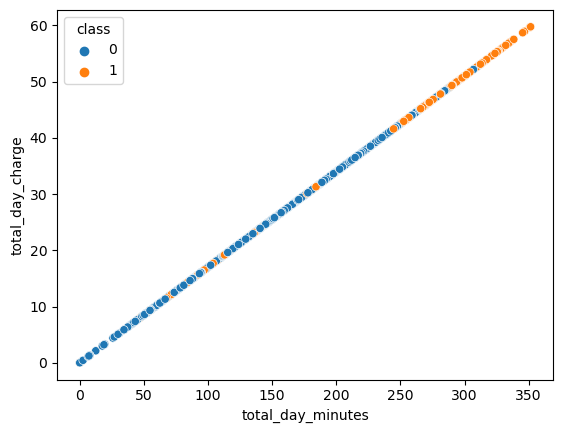

In [28]:
sns.scatterplot(data=churn, x="total_day_minutes", y="total_day_charge",hue='class')

C:\Users\user\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


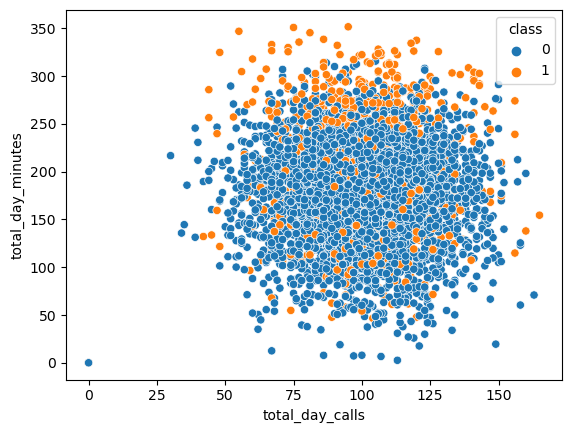

In [29]:
sns.scatterplot(churn.total_day_calls, churn.total_day_minutes, hue =churn['class'])
plt.show()

In [33]:
churn['total_minutes']= churn['total_night_minutes']+ churn['total_day_minutes']+ churn['total_intl_minutes']

In [34]:
churn.drop('total_minutes',axis=1)

,state,account_length,area_code,phone_number,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,class
0,16,128,415,2845,0,1,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,35,107,415,2301,0,1,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0
2,31,137,415,1616,0,0,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0
3,35,84,408,2510,1,0,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
4,36,75,415,155,1,0,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,11,50,408,2000,0,1,40,235.7,127,40.07,...,126,18.96,297.5,116,13.39,9.9,5,2.67,2,0
4996,49,152,415,394,0,0,0,184.2,90,31.31,...,73,21.83,213.6,113,9.61,14.7,2,3.97,3,1
4997,7,61,415,313,0,0,0,140.6,89,23.90,...,128,14.69,212.4,97,9.56,13.6,4,3.67,1,0
4998,7,109,510,3471,0,0,0,188.8,67,32.10,...,92,14.59,224.4,89,10.10,8.5,6,2.30,0,0


In [35]:
churn['Total_charge'] = churn['total_day_charge']+churn['total_eve_charge']+churn['total_night_charge']+churn['total_intl_charge']


In [36]:
churn['Total_calls'] = churn['total_day_calls']+churn['total_eve_calls']+churn['total_eve_calls']+churn['total_intl_calls']

In [37]:
churn.head()

,state,account_length,area_code,phone_number,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,...,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,class,total_minutes,Total_charge,Total_calls
0,16,128,415,2845,0,1,25,265.1,110,45.07,...,91,11.01,10.0,3,2.70,1,0,519.8,75.56,311
1,35,107,415,2301,0,1,26,161.6,123,27.47,...,103,11.45,13.7,3,3.70,1,0,429.7,59.24,332
2,31,137,415,1616,0,0,0,243.4,114,41.38,...,104,7.32,12.2,5,3.29,0,0,418.2,62.29,339
3,35,84,408,2510,1,0,0,299.4,71,50.90,...,89,8.86,6.6,7,1.78,2,0,502.9,66.80,254
4,36,75,415,155,1,0,0,166.7,113,28.34,...,121,8.41,10.1,3,2.73,3,0,363.7,52.09,360


In [39]:
churn.drop('total_minutes',axis=1)

,state,account_length,area_code,phone_number,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,...,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,class,Total_charge,Total_calls
0,16,128,415,2845,0,1,25,265.1,110,45.07,...,244.7,91,11.01,10.0,3,2.70,1,0,75.56,311
1,35,107,415,2301,0,1,26,161.6,123,27.47,...,254.4,103,11.45,13.7,3,3.70,1,0,59.24,332
2,31,137,415,1616,0,0,0,243.4,114,41.38,...,162.6,104,7.32,12.2,5,3.29,0,0,62.29,339
3,35,84,408,2510,1,0,0,299.4,71,50.90,...,196.9,89,8.86,6.6,7,1.78,2,0,66.80,254
4,36,75,415,155,1,0,0,166.7,113,28.34,...,186.9,121,8.41,10.1,3,2.73,3,0,52.09,360
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,11,50,408,2000,0,1,40,235.7,127,40.07,...,297.5,116,13.39,9.9,5,2.67,2,0,75.09,384
4996,49,152,415,394,0,0,0,184.2,90,31.31,...,213.6,113,9.61,14.7,2,3.97,3,1,66.72,238
4997,7,61,415,313,0,0,0,140.6,89,23.90,...,212.4,97,9.56,13.6,4,3.67,1,0,51.82,349
4998,7,109,510,3471,0,0,0,188.8,67,32.10,...,224.4,89,10.10,8.5,6,2.30,0,0,59.09,257


C:\Users\user\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


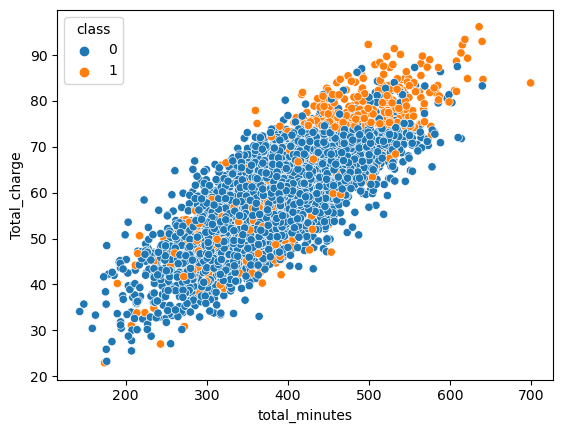

In [40]:
sns.scatterplot(churn.total_minutes, churn.Total_charge, hue =churn['class'])
plt.show()

### SVM Model kernel = "Linear"

In [41]:
x=churn[['international_plan','total_minutes','Total_charge','number_customer_service_calls']]
y=churn['class']

In [42]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=42)

In [43]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(4000, 4)
(1000, 4)
(4000,)
(1000,)


In [44]:
model=SVC(kernel="rbf",  C=0.0001)

In [45]:
model.fit(x_train,y_train)

SVC(C=0.0001)

In [46]:
model.support_vectors_

array([[  0.  , 300.9 ,  39.32,   3.  ],
       [  0.  , 452.  ,  74.32,   1.  ],
       [  0.  , 397.9 ,  73.76,   1.  ],
       ...,
       [  0.  , 535.7 ,  84.56,   0.  ],
       [  0.  , 563.8 ,  80.71,   0.  ],
       [  0.  , 495.5 ,  68.38,   3.  ]])

In [47]:
y_pred=model.predict(x_test)

In [48]:
y_pred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [49]:
y_test

1501    0
2586    0
2653    0
1055    0
705     0
       ..
4711    0
2313    0
3214    0
2732    1
1926    0
Name: class, Length: 1000, dtype: int64

In [50]:
classification_metrics(y_test,y_pred)

Accuracy is:  0.861
Precision is:  0.0
Recall is:  0.0
F1-Score is:  0.0


C:\Users\user\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [51]:
y_train_test=model.predict(x_train)

In [52]:
classification_metrics(y_train,y_train_test)

Accuracy is:  0.858
Precision is:  0.0
Recall is:  0.0
F1-Score is:  0.0


C:\Users\user\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# KNN

In [53]:
from sklearn.neighbors import KNeighborsClassifier 

In [54]:
mod_knn=KNeighborsClassifier()  #K=5

In [55]:
mod_knn.fit(x_train,y_train)

KNeighborsClassifier()

In [56]:
y_knn_pred=mod_knn.predict(x_test)

C:\Users\user\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


In [57]:
y_knn_pred

array([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,

In [58]:
y_test

1501    0
2586    0
2653    0
1055    0
705     0
       ..
4711    0
2313    0
3214    0
2732    1
1926    0
Name: class, Length: 1000, dtype: int64

In [59]:
classification_metrics(y_test,y_knn_pred)

Accuracy is:  0.891
Precision is:  0.6973684210526315
Recall is:  0.381294964028777
F1-Score is:  0.49302325581395356


In [60]:
parameters =  {'n_neighbors':[3,5,10,20,30]}
grid_mod_knn = GridSearchCV(mod_knn, parameters)
grid_mod_knn.fit(x_train, y_train)

C:\Users\user\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\user\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims`

C:\Users\user\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
C:\Users\user\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims`

GridSearchCV(estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': [3, 5, 10, 20, 30]})

In [61]:
grid_mod_knn.best_params_

{'n_neighbors': 5}

In [62]:
grid_mod_knn.best_score_

0.89225

# Naive_Bayesian

In [63]:
model=GaussianNB()
model.fit(x_train,y_train)

GaussianNB()

In [64]:
y_pred=model.predict(x_test)

In [65]:
classification_metrics(y_test,y_pred)

Accuracy is:  0.838
Precision is:  0.42483660130718953
Recall is:  0.4676258992805755
F1-Score is:  0.44520547945205474


<AxesSubplot:>

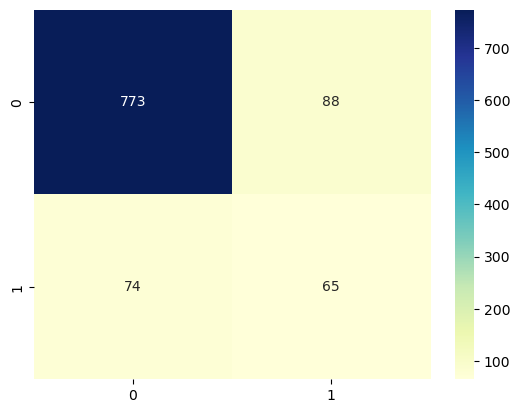

In [66]:
sns.heatmap(confusion_matrix(y_test,y_pred), annot=True, fmt='d', cmap='YlGnBu')


In [67]:
y_pred_train=model.predict(x_train)


In [68]:
classification_metrics(y_train,y_pred_train)

Accuracy is:  0.85175
Precision is:  0.4760076775431862
Recall is:  0.43661971830985913
F1-Score is:  0.4554637281910009


# ROC

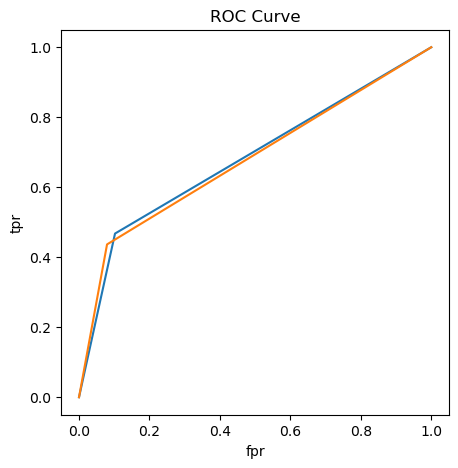

In [69]:
plt.figure(figsize=(5,5))
fpr, tpr, thresholds = roc_curve(y_test ,y_pred)
fpr1, tpr1, thresholds1 = roc_curve(y_train ,y_pred_train)
plt.plot(fpr, tpr)
plt.plot(fpr1, tpr1)
plt.xlabel("fpr")
plt.ylabel("tpr")
plt.title("ROC Curve")
plt.show()

# Decision Tree Model

In [70]:
model_dt=DecisionTreeClassifier()

In [71]:
model_dt.fit(x_train,y_train)

DecisionTreeClassifier()

In [72]:
y_pred_dt=model_dt.predict(x_test)

In [73]:
y_pred_dt

array([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0,
       1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,

In [74]:
classification_metrics(y_test,y_pred_dt)

Accuracy is:  0.885
Precision is:  0.5882352941176471
Recall is:  0.5755395683453237
F1-Score is:  0.5818181818181818


In [75]:
y_pred_dt_train=model_dt.predict(x_train)

In [76]:
classification_metrics(y_train,y_pred_dt_train)

Accuracy is:  1.0
Precision is:  1.0
Recall is:  1.0
F1-Score is:  1.0


# ROC

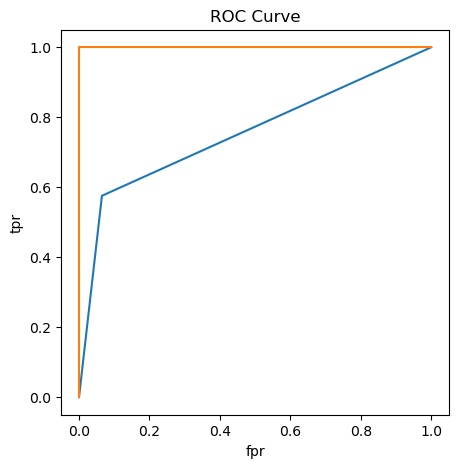

In [77]:
plt.figure(figsize=(5,5))
fpr, tpr, thresholds = roc_curve(y_test ,y_pred_dt)
fpr1, tpr1, thresholds1 = roc_curve(y_train ,y_pred_dt_train)
plt.plot(fpr, tpr)
plt.plot(fpr1, tpr1)
plt.xlabel("fpr")
plt.ylabel("tpr")
plt.title("ROC Curve")
plt.show()

# Overfitting

In [78]:
model_dt=DecisionTreeClassifier(max_depth=3)

In [79]:
model_dt.fit(x_train,y_train)

DecisionTreeClassifier(max_depth=3)

In [80]:
y_pred_dt=model_dt.predict(x_test)

In [81]:
y_pred_dt

array([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,

In [82]:
classification_metrics(y_test,y_pred_dt)

Accuracy is:  0.933
Precision is:  0.8272727272727273
Recall is:  0.6546762589928058
F1-Score is:  0.7309236947791165


In [83]:
y_pred_dt_train=model_dt.predict(x_train)

In [84]:
classification_metrics(y_train,y_pred_dt_train)

Accuracy is:  0.9345
Precision is:  0.8415178571428571
Recall is:  0.6637323943661971
F1-Score is:  0.7421259842519684


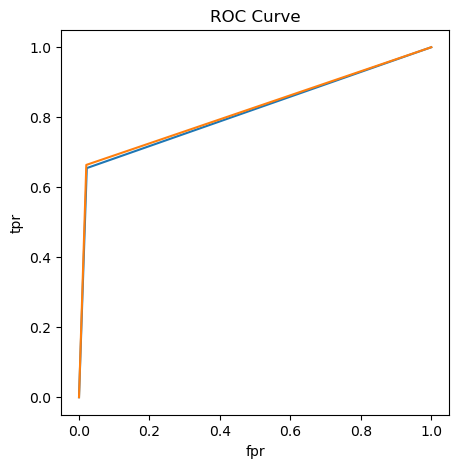

In [85]:
plt.figure(figsize=(5,5))
fpr, tpr, thresholds = roc_curve(y_test ,y_pred_dt)
fpr1, tpr1, thresholds1 = roc_curve(y_train ,y_pred_dt_train)
plt.plot(fpr, tpr)
plt.plot(fpr1, tpr1)
plt.xlabel("fpr")
plt.ylabel("tpr")
plt.title("ROC Curve")
plt.show()

# # Bagging Random Forest Model


In [86]:
RFmodel=RandomForestClassifier()

In [87]:
RFmodel.fit(x_train,y_train)

RandomForestClassifier()

In [88]:
y_predRF=RFmodel.predict(x_test)

In [89]:
classification_metrics(y_test,y_predRF)

Accuracy is:  0.914
Precision is:  0.7054263565891473
Recall is:  0.6546762589928058
F1-Score is:  0.6791044776119404


In [90]:
y_predRF_train=RFmodel.predict(x_train)

In [91]:
classification_metrics(y_train,y_predRF_train)

Accuracy is:  1.0
Precision is:  1.0
Recall is:  1.0
F1-Score is:  1.0


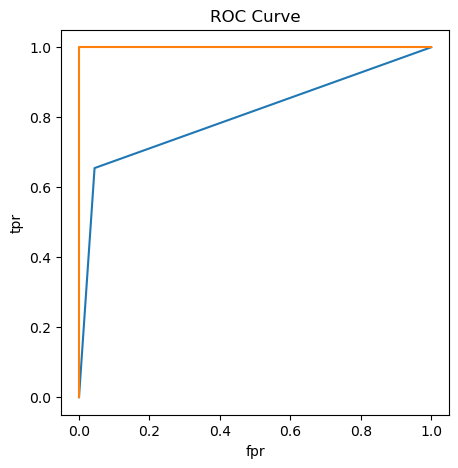

In [92]:
roc_curve_plot(y_test,y_predRF,y_train,y_predRF_train)

# Overfitting

In [93]:
RFmodel=RandomForestClassifier(max_depth=3)

In [94]:
RFmodel.fit(x_train,y_train)

RandomForestClassifier(max_depth=3)

In [95]:
y_predRF=RFmodel.predict(x_test)

In [96]:
classification_metrics(y_test,y_predRF)

Accuracy is:  0.934
Precision is:  0.8288288288288288
Recall is:  0.6618705035971223
F1-Score is:  0.7360000000000001


In [97]:
y_predRF_train=RFmodel.predict(x_train)

In [98]:
classification_metrics(y_train,y_predRF_train)

Accuracy is:  0.93475
Precision is:  0.8388520971302428
Recall is:  0.6690140845070423
F1-Score is:  0.7443682664054847


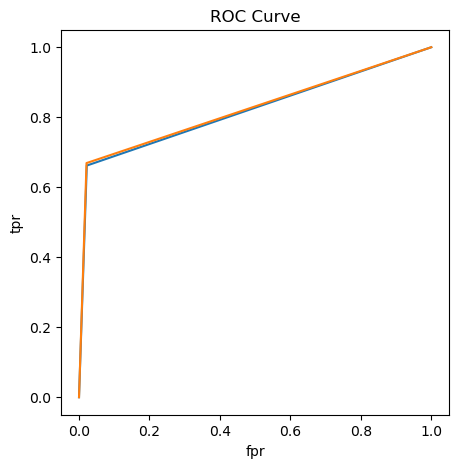

In [99]:
roc_curve_plot(y_test,y_predRF,y_train,y_predRF_train)

In [100]:
mod=RandomForestClassifier()
parameters=[{'max_depth':[3,5,7,10,12,15,16]}]
grid_model=RandomizedSearchCV(param_distributions=parameters,estimator=mod)

In [101]:
grid_model.fit(x_train,y_train)

C:\Users\user\anaconda3\lib\site-packages\sklearn\model_selection\_search.py:292: UserWarning: The total space of parameters 7 is smaller than n_iter=10. Running 7 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


RandomizedSearchCV(estimator=RandomForestClassifier(),
                   param_distributions=[{'max_depth': [3, 5, 7, 10, 12, 15,
                                                       16]}])

In [102]:
grid_model.best_params_

{'max_depth': 3}

In [103]:
grid_model.best_score_

0.932

# Adamodel

In [104]:
Adamodel=AdaBoostClassifier(n_estimators=1000)

In [ ]:
Adamodel.fit(x_train,y_train)

In [266]:
y_predAda=Adamodel.predict(x_test)

In [267]:
classification_metrics(y_test,y_predAda)

Accuracy is:  0.9
Precision is:  0.6788990825688074
Recall is:  0.5323741007194245
F1-Score is:  0.5967741935483871


In [268]:
y_predAda_train=RFmodel.predict(x_train)

In [269]:
classification_metrics(y_train,y_predAda_train)

Accuracy is:  0.93525
Precision is:  0.8456375838926175
Recall is:  0.6654929577464789
F1-Score is:  0.7448275862068965


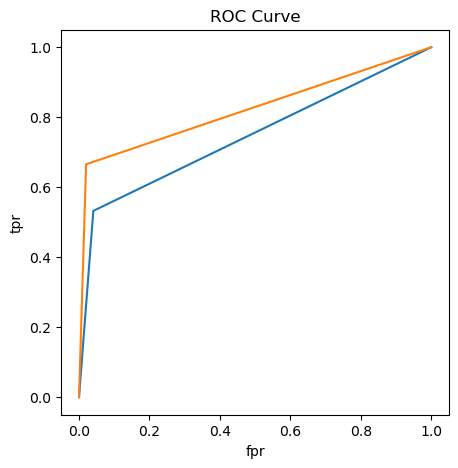

In [270]:
roc_curve_plot(y_test,y_predAda,y_train,y_predAda_train)